# Homework Assignment 1
### [The Art of Analyzing Big Data - The Data Scientist’s Toolbox](https://www.ise.bgu.ac.il/labs/fire/lectures.html)
#### By Dr. Michael Fire

For this homework you will need to write code that analyzes real-world datasets. The code needs to be written in Python using the [sqlite3](https://docs.python.org/2/library/sqlite3.html) package.

**Please note:** You need to answer only the questions that match your ID first digit.

## Setting Kaggle's Datasets API

In [ ]:
!mkdir /root/.kaggle/

In [ ]:
import json
import os

# Installing the Kaggle package
!pip install kaggle

#Important Note: complete this with your own key - after running this for the first time remmember to **remove** your API_KEY
api_token = {"username":"","key":""}


# creating kaggle.json file with the personal API-Key details
# You can also put this file on your Google Drive
with open('/root/.kaggle/kaggle.json', 'w') as file:
  json.dump(api_token, file)
!chmod 600 /root/.kaggle/kaggle.json

# 1. Babies Names Dataset (35pt)

### Dowload Babies Names Dataset

In [ ]:
!kaggle datasets list -s baby

ref                                                      title                                size  lastUpdated          downloadCount  voteCount  usabilityRating  
-------------------------------------------------------  ----------------------------------  -----  -------------------  -------------  ---------  ---------------  
datasets/kaggle/us-baby-names                            US Baby Names                       173MB  2017-11-21 22:18:15          28342        314  0.5882353        
datasets/ironicninja/baby-names                          Baby Names                            5MB  2021-02-09 16:21:40            298          9  0.88235295       
datasets/haezer/french-baby-names                        French Baby Names                    18MB  2020-04-07 16:32:38            338         13  0.88235295       
datasets/new-york-city/nyc-baby-names                    NYC Baby Names                      136KB  2017-09-08 20:04:20            699         10  0.7058824        
datasets/r

In [ ]:
# Creating a dataset directory
!mkdir ./datasets
!mkdir ./datasets/us-baby-name

# download the dataset from Kaggle and unzip it
!kaggle datasets download kaggle/us-baby-names -f database.sqlite -p ./datasets/us-baby-name/database.sqlite
!chdir ./datasets/us-baby-name/database.sqlite/
!unzip ./datasets/us-baby-name/database.sqlite/*.zip  -d ./datasets/us-baby-name/database.sqlite

 90% 118M/131M [00:01<00:00, 124MB/s]
100% 131M/131M [00:01<00:00, 77.6MB/s]
/bin/bash: chdir: command not found
Archive:  ./datasets/us-baby-name/database.sqlite/database.sqlite.zip
  inflating: ./datasets/us-baby-name/database.sqlite/database.sqlite  


In [ ]:
!unzip ./datasets/us-baby-name/database.sqlite/*.zip  -d ./datasets/us-baby-name/database.sqlite

Archive:  ./datasets/us-baby-name/database.sqlite/database.sqlite.zip
replace ./datasets/us-baby-name/database.sqlite/database.sqlite? [y]es, [n]o, [A]ll, [N]one, [r]ename: y
  inflating: ./datasets/us-baby-name/database.sqlite/database.sqlite  


In [ ]:
import sqlite3
import matplotlib
import matplotlib.pyplot as plt
import os
%matplotlib inline

In [ ]:
DB_PATH = './datasets/us-baby-name/database.sqlite'

In [ ]:
conn = sqlite3.connect(f'{DB_PATH}/database.sqlite') # connecting to the database

**Task 1 (for everyone):** Write a code that uses the  [**babies names dataset** ](https://www.kaggle.com/kaggle/us-baby-names?select=NationalNames.csv) (use NationalNames.csv) and creates a table named (Names) with the dataset data and the following columns: 'State', 'Gender', 'Name', 'Count' , and 'Year' (5pt)
**Bonus:** Load the data using a Batch INSERT SQL Query (2pt)

In [ ]:
c = conn.cursor() # creating a cursor object
c.execute("""CREATE TABLE IF NOT EXISTS Names (
  State TEXT,
  Gender TEXT,
  Name TEXT,
  Count INTEGER,
  Year INTEGER)""" ) # creates a table named (Names)
conn.commit()
c.close() # close the cursor

In [ ]:
c = conn.cursor()
data = c.execute("SELECT State, Gender, Name, Count, Year FROM StateNames").fetchall()
c.executemany("INSERT INTO Names (State, Gender, Name, Count, Year) VALUES (?,?,?,?,?)", data) # Bonus - Load the data using a Batch INSERT SQL Query
conn.commit()
c.close() # close the cursor

# c = conn.cursor()
# c.execute("""INSERT INTO Names (State,Gender,Name,Count,Year)
#   SELECT s.State, s.Gender, s.Name, s.Count, s.Year
#   FROM StateNames as s""")
# conn.commit()
# c.close() # close the cursor

**Task 2 (for everyone):** Write a query that returns the statistics for the name Mary (5pt). Use the [the timeit package](https://docs.python.org/3/library/timeit.html) to measure the time it takes the query to run (5pt). **Bonus:** [Create an index](https://www.w3schools.com/sql/sql_create_index.asp)  on the _Name_ column and use the [the timeit package](https://docs.python.org/3/library/timeit.html) to measure the time it takes the query to run with the index (5pt)

In [ ]:
import timeit

In [ ]:
# Mary statistics and runtime
c = conn.cursor()

starttime = timeit.default_timer() # The start time

query = """ SELECT (sum_mary_count/sum_count)*100
        FROM (SELECT 1.0*Sum(Count) as sum_mary_count FROM Names WHERE Name='Mary' GROUP BY Name) , (SELECT 1.0*Sum(Count) as sum_count FROM Names)"""

stat = c.execute(query).fetchone()[0]

endtime = timeit.default_timer() # The end time

print(" Statistics for the name Mary: " + str(stat) + " % of babis with the name Mary")
print(" Query runtime : " + str(endtime - starttime) + " seconds ")


c.close() # close the cursor

 Statistics for the name Mary: 1.2514900212265436 % of babis with the name Mary
 Query runtime : 0.9847400570000104 seconds 


In [ ]:
# Bonus
c = conn.cursor()

c.execute(" CREATE INDEX idx_name ON Names (Name) ")
conn.commit()

starttime = timeit.default_timer() # The start time

stat = c.execute(query).fetchone()[0]

endtime = timeit.default_timer() # The end time

print(" Statistics for the name Mary: " + str(stat) + "% of babis with the name Mary")
print(" Query runtime : " + str(endtime - starttime) + " seconds ")

c.close() # close the cursor

 Statistics for the name Mary: 1.2514900212265436% of babis with the name Mary
 Query runtime : 0.44213296000000923 seconds 


### <span style="color:red"> Please answer only **one** of the following questions according to your ID number (use the formula **<YOUR_ID> mod 4 +1**) </span>

In [ ]:
# which question to answer - put your ID number and run the code
your_id  = "313326985"
q = int(your_id) % 4 + 1
print("You need to answer question number %s" % q)

You need to answer question number 2


***Question 1:*** Write a function that returns how many babies were born in a given state in a given year.
Use it to calculate the number of babies born in TX in 1986 (10pt)

***Question 2:*** Write a function that returns how many female babies were born between a given range of years.
Use it to calculate how many babies were born between 1988 and 1995  (10pt)

In [ ]:
def count_female_babies(first_year, second_year):
  c = conn.cursor()
  count = c.execute("SELECT Sum(Count) FROM Names WHERE Gender = 'F' AND Year BETWEEN (?) and (?)", (first_year, second_year)).fetchone()
  c.close() # close the cursor
  return count[0]

In [ ]:
first = 1988
second = 1995
print(" Number of female babies that were born between " + str(first) + " and " + str(second) + ": " + str(count_female_babies(first, second)))

 Number of female babies that were born between 1988 and 1995: 12654725


**Question 3:** Write a function that returns the most common female name in a given state. Use it to calculate the most common female name in Wasington in 1987 (10pt)

**Question 4:** Write a function that returns how many male babies named _Robert where born in a given state in a given year. Use it to find the state in which the highest number of babies _Robert_ where born in 2010 (10pt)

**Question (for everyone):** For the state of CA write code that calculates the second most popular female/male names in each decade (10pt). **Bonus**: Visualize it somehow using Matplotlib (5pt)

In [ ]:
import pandas as pd

In [ ]:
c = conn.cursor()

df = pd.read_sql_query("""SELECT *
             FROM Names
             WHERE State='CA'""", conn)

c.close() # close the cursor

In [ ]:
df['Decade'] = df['Year'].apply(lambda x: int(x/10)*10)

In [ ]:
df

,State,Gender,Name,Count,Year,Decade
0,CA,F,Mary,295,1910,1910
1,CA,F,Helen,239,1910,1910
2,CA,F,Dorothy,220,1910,1910
3,CA,F,Margaret,163,1910,1910
4,CA,F,Frances,134,1910,1910
...,...,...,...,...,...,...
354208,CA,M,Zakary,5,2014,2010
354209,CA,M,Zealand,5,2014,2010
354210,CA,M,Ziad,5,2014,2010
354211,CA,M,Zidane,5,2014,2010


In [ ]:
count_names_decade = df.groupby(['Name','Decade']).agg(Count_Decade = ('Count', 'sum'))


In [ ]:
count_names_decade

Count_Decade
Name   Decade              
Aadan  2000              13
       2010               5
Aaden  2000             313
       2010             198
Aadhav 2010               6
...                     ...
Zyon   1990               6
       2000              25
       2010              17
Zyra   2010              16
Zyrah  2010               5

[62947 rows x 1 columns]

In [ ]:
# Sort by two columns
sort_df = count_names_decade.sort_values(['Decade', 'Count_Decade'],ascending = [False,False])

In [ ]:
sort_df = sort_df.reset_index()
sort_df

,Name,Decade,Count_Decade
0,Sophia,2010,17166
1,Jacob,2010,15054
2,Isabella,2010,15013
3,Daniel,2010,13839
4,Jayden,2010,13480
...,...,...,...
62942,Yasuko,1910,5
62943,Yoshimi,1910,5
62944,Yukiye,1910,5
62945,Zita,1910,5


In [ ]:
decades = sort_df['Decade'].unique()

In [ ]:
Names = []
Count = []
for d in decades:
  decade_second_name = sort_df.loc[sort_df['Decade'] == d].iloc[[1]]
  Names.append(f" {decade_second_name['Name'].values[0]} \n {decade_second_name['Decade'].values[0]} - {decade_second_name['Decade'].values[0]+9}")
  Count.append(decade_second_name['Count_Decade'].values[0])
  print(f" {decade_second_name['Name'].values[0]} {decade_second_name['Decade'].values[0]} - {decade_second_name['Decade'].values[0]+9}")
c.close() # close the cursor

 Jacob 2010 - 2019
 Anthony 2000 - 2009
 Daniel 1990 - 1999
 Christopher 1980 - 1989
 Jennifer 1970 - 1979
 David 1960 - 1969
 Robert 1950 - 1959
 John 1940 - 1949
 Richard 1930 - 1939
 Mary 1920 - 1929
 John 1910 - 1919


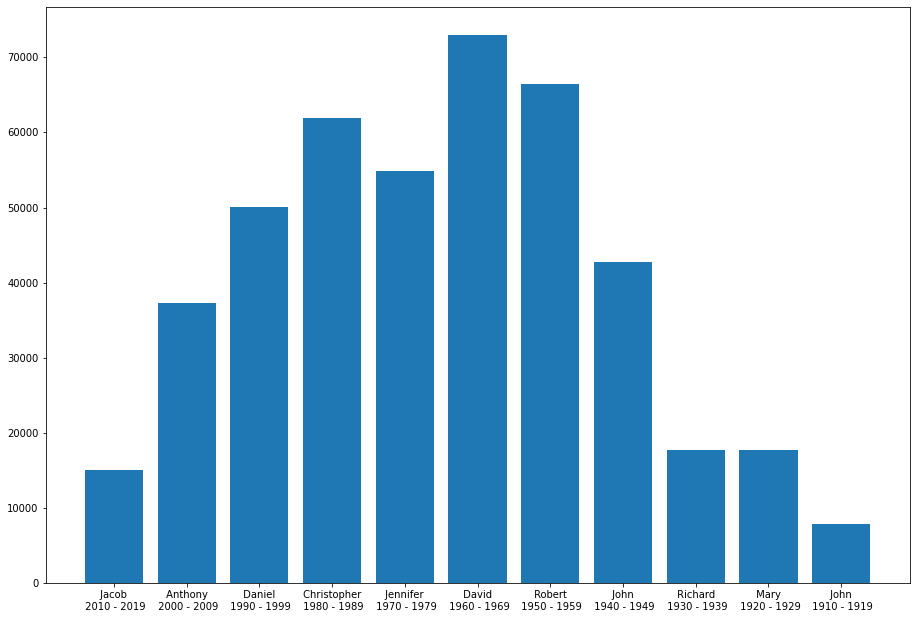

In [ ]:
# Bonus
fig = plt.figure()
ax = fig.add_axes([2,2,2,2])
ax.bar(Names,Count)
plt.show()

# 2. Flavors of Cacao Dataset (15pt)

Using the [Flavors of Cacao](https://www.kaggle.com/rombikuboktaeder/choco-flavors) dataset, answer the following questions:

### Dowload Flavors of Cacao Dataset

In [ ]:
!kaggle datasets list -s choco_flavors

ref                                      title          size  lastUpdated          downloadCount  voteCount  usabilityRating  
---------------------------------------  -------------  ----  -------------------  -------------  ---------  ---------------  
datasets/rombikuboktaeder/choco-flavors  choco_flavors  30KB  2018-04-01 04:36:29           1772          6  0.23529412       


In [ ]:
# Creating a dataset directory
!mkdir ./datasets/choco-flavors

# download the dataset from Kaggle and unzip it
!kaggle datasets download rombikuboktaeder/choco-flavors -p ./datasets/choco-flavors
!unzip ./datasets/choco-flavors/choco-flavors.zip -d ./datasets/choco-flavors/



  0% 0.00/30.3k [00:00<?, ?B/s]
100% 30.3k/30.3k [00:00<00:00, 19.1MB/s]
Archive:  ./datasets/choco-flavors/choco-flavors.zip
  inflating: ./datasets/choco-flavors/flavors_of_cacao.csv  


In [ ]:
!touch ./datasets/choco-flavors/db.sqlite

In [ ]:
DB_PATH = './datasets/choco-flavors/db.sqlite'

In [ ]:
conn = sqlite3.connect(f'{DB_PATH}') # connecting to the database

In [ ]:
c = conn.cursor() # creating a cursor object
c.execute("""CREATE TABLE Cacao
          (Company TEXT,
          SpecificBeanOriginBarName TEXT,
          REF INTEGER,
          ReviewDate INTEGER,
          CocoaPercent TEXT,
          CompanyLocation TEXT,
          Rating DECIMAL,
          BeanType TEXT,
          BroadBeanOrigin TEXT)""" ) # creates a table named (Names)
conn.commit()
c.close() # close the cursor

In [ ]:
df = pd.read_csv('./datasets/choco-flavors/flavors_of_cacao.csv')
df

,Company \n(Maker-if known),Specific Bean Origin\nor Bar Name,REF,Review\nDate,Cocoa\nPercent,Company\nLocation,Rating,Bean\nType,Broad Bean\nOrigin
0,A. Morin,Agua Grande,1876,2016,63%,France,3.75,,Sao Tome
1,A. Morin,Kpime,1676,2015,70%,France,2.75,,Togo
2,A. Morin,Atsane,1676,2015,70%,France,3.00,,Togo
3,A. Morin,Akata,1680,2015,70%,France,3.50,,Togo
4,A. Morin,Quilla,1704,2015,70%,France,3.50,,Peru
...,...,...,...,...,...,...,...,...,...
1790,Zotter,Peru,647,2011,70%,Austria,3.75,,Peru
1791,Zotter,Congo,749,2011,65%,Austria,3.00,Forastero,Congo
1792,Zotter,Kerala State,749,2011,65%,Austria,3.50,Forastero,India
1793,Zotter,Kerala State,781,2011,62%,Austria,3.25,,India


In [ ]:
df.columns = ['Company', 'SpecificBeanOriginBarName', 'REF', 'ReviewDate', 'CocoaPercent', 'CompanyLocation','Rating','BeanType','BroadBeanOrigin']

In [ ]:
from sqlalchemy import create_engine

df.to_sql('Cacao', con=conn, if_exists='append',index=False)

In [ ]:
DB_PATH = './datasets/choco-flavors/flavors_of_cacao.csv'
df = pd.read_csv(DB_PATH)
df

,Company \n(Maker-if known),Specific Bean Origin\nor Bar Name,REF,Review\nDate,Cocoa\nPercent,Company\nLocation,Rating,Bean\nType,Broad Bean\nOrigin
0,A. Morin,Agua Grande,1876,2016,63%,France,3.75,,Sao Tome
1,A. Morin,Kpime,1676,2015,70%,France,2.75,,Togo
2,A. Morin,Atsane,1676,2015,70%,France,3.00,,Togo
3,A. Morin,Akata,1680,2015,70%,France,3.50,,Togo
4,A. Morin,Quilla,1704,2015,70%,France,3.50,,Peru
...,...,...,...,...,...,...,...,...,...
1790,Zotter,Peru,647,2011,70%,Austria,3.75,,Peru
1791,Zotter,Congo,749,2011,65%,Austria,3.00,Forastero,Congo
1792,Zotter,Kerala State,749,2011,65%,Austria,3.50,Forastero,India
1793,Zotter,Kerala State,781,2011,62%,Austria,3.25,,India


**Question 1:** Write a function that returns the number of bars manufactured where the bars' BroadBean Origin is a given country. Use the function to calculate the number of bars where BroadBean Origin is 'Fiji' (15pt)

**Question 2:** Write a function that returns the maximal and average cocoa percentage in a bar manufactured by a company in a specific country. Use the function to calculate the minimal and average cocoa percentage in bars manufactured by a Swiss company (15pt).

In [ ]:
def max_avg(country):

  c = conn.cursor() # creating a cursor object
  result = c.execute("SELECT max(percent), avg(percent) FROM (SELECT CAST(CocoaPercent AS int) as percent FROM Cacao WHERE CompanyLocation='"+country+"')").fetchall() # creates a table named (Names)
  conn.commit()
  c.close() # close the cursor

  return result[0][0], result[0][1]

In [ ]:
max, avg = max_avg('Switzerland')
print("The maximal cocoa percentage in bars manufactured by a Swiss company: " + str(max))
print("The average cocoa percentage in bars manufactured by a Swiss company: " + str(avg))

The maximal cocoa percentage in bars manufactured by a Swiss company: 88
The average cocoa percentage in bars manufactured by a Swiss company: 71.21052631578948


**Question 3:** Calculate the second most common bean type(s) and the most rare bean type(s) (15
pt)

**Question 4:** Calculate the number of reviews and the average rating in each year. Calculate the number of reviews and the average rating of each company in each year (15pt)

# 3. Kickstarter Projects Dataset (25pt)

Using the [Kickstarter Projects Dataset](https://www.kaggle.com/kemical/kickstarter-projects#ks-projects-201801.csv), answer the following questions:

**Task 1 (for everyone):** Load the dataset to SQLite DB using [PonyORM](https://ponyorm.org) (10pt)

### Dowload Kickstarter Projects Dataset

In [ ]:
!kaggle datasets list -s kickstarter

ref                                                              title                                       size  lastUpdated          downloadCount  voteCount  usabilityRating  
---------------------------------------------------------------  ------------------------------------------  ----  -------------------  -------------  ---------  ---------------  
datasets/kemical/kickstarter-projects                            Kickstarter Projects                        37MB  2018-02-08 09:02:30          61008       1492  0.7941176        
datasets/socathie/kickstarter-project-statistics                 Kickstarter Project Statistics               1MB  2019-11-14 06:38:31           6323        125  0.7058824        
datasets/codename007/funding-successful-projects                 Funding Successful Projects on Kickstarter  20MB  2017-06-20 17:37:38           3148        115  0.88235295       
datasets/yashkantharia/kickstarter-campaigns                     Kickstarter Campaigns              

In [ ]:
# Creating a dataset directory
!mkdir ./datasets/kickstarter-projects

# download the dataset from Kaggle and unzip it
!kaggle datasets download kemical/kickstarter-projects -p ./datasets/kickstarter-projects
!unzip ./datasets/kickstarter-projects/kickstarter-projects.zip -d ./datasets/kickstarter-projects/



 84% 31.0M/36.8M [00:00<00:00, 176MB/s] 
100% 36.8M/36.8M [00:00<00:00, 147MB/s]
Archive:  ./datasets/kickstarter-projects/kickstarter-projects.zip
  inflating: ./datasets/kickstarter-projects/ks-projects-201612.csv  
  inflating: ./datasets/kickstarter-projects/ks-projects-201801.csv  


In [ ]:
!pip install pony

     |████████████████████████████████| 313 kB 9.1 MB/s 


In [ ]:
from pony.orm import *
# Creating a new database
db = Database()
db.bind(provider='sqlite', filename='/content/datasets/kickstarter-projects/kickstarter-projects.pony.db', create_db=True) # notice we can easily use other type of databases instead of SQLite

In [ ]:
from datetime import datetime

# Each class will be map to a table
class KickStarter(db.Entity):
    id = PrimaryKey(int)
    name = Required(str)
    category = Required(str)
    main_category = Required(str)
    currency = Required(str)
    deadline = Required(datetime)
    goal = Required(float)
    launched = Required(datetime)
    pledged = Required(float)
    state = Required(str)
    backers = Required(int)
    country = Required(str)
    usd_pledged = Optional(float)
    usd_pledged_real = Required(float)
    usd_goal_real = Required(float)

In [ ]:
show(KickStarter)

class KickStarter(Entity):
    id = PrimaryKey(int)
    name = Required(str)
    category = Required(str)
    main_category = Required(str)
    currency = Required(str)
    deadline = Required(datetime)
    goal = Required(float)
    launched = Required(datetime)
    pledged = Required(float)
    state = Required(str)
    backers = Required(int)
    country = Required(str)
    usd_pledged = Optional(float)
    usd_pledged_real = Required(float)
    usd_goal_real = Required(float)


In [ ]:
set_sql_debug(True) # helps to see what SQL commands are running
db.generate_mapping(create_tables=True) # create tables

GET CONNECTION FROM THE LOCAL POOL
PRAGMA foreign_keys = false
BEGIN IMMEDIATE TRANSACTION
CREATE TABLE "KickStarter" (
  "id" INTEGER NOT NULL PRIMARY KEY,
  "name" TEXT NOT NULL,
  "category" TEXT NOT NULL,
  "main_category" TEXT NOT NULL,
  "currency" TEXT NOT NULL,
  "deadline" DATETIME NOT NULL,
  "goal" REAL NOT NULL,
  "launched" DATETIME NOT NULL,
  "pledged" REAL NOT NULL,
  "state" TEXT NOT NULL,
  "backers" INTEGER NOT NULL,
  "country" TEXT NOT NULL,
  "usd_pledged" REAL,
  "usd_pledged_real" REAL NOT NULL,
  "usd_goal_real" REAL NOT NULL
)

SELECT "KickStarter"."id", "KickStarter"."name", "KickStarter"."category", "KickStarter"."main_category", "KickStarter"."currency", "KickStarter"."deadline", "KickStarter"."goal", "KickStarter"."launched", "KickStarter"."pledged", "KickStarter"."state", "KickStarter"."backers", "KickStarter"."country", "KickStarter"."usd_pledged", "KickStarter"."usd_pledged_real", "KickStarter"."usd_goal_real"
FROM "KickStarter" "KickStarter"
WHERE 0 = 

In [ ]:
import pandas as pd

df = pd.read_csv('./datasets/kickstarter-projects/ks-projects-201801.csv')
df

,ID,name,category,main_category,currency,deadline,goal,launched,pledged,state,backers,country,usd pledged,usd_pledged_real,usd_goal_real
0,1000002330,The Songs of Adelaide & Abullah,Poetry,Publishing,GBP,2015-10-09,1000.0,2015-08-11 12:12:28,0.0,failed,0,GB,0.0,0.0,1533.95
1,1000003930,Greeting From Earth: ZGAC Arts Capsule For ET,Narrative Film,Film & Video,USD,2017-11-01,30000.0,2017-09-02 04:43:57,2421.0,failed,15,US,100.0,2421.0,30000.00
2,1000004038,Where is Hank?,Narrative Film,Film & Video,USD,2013-02-26,45000.0,2013-01-12 00:20:50,220.0,failed,3,US,220.0,220.0,45000.00
3,1000007540,ToshiCapital Rekordz Needs Help to Complete Album,Music,Music,USD,2012-04-16,5000.0,2012-03-17 03:24:11,1.0,failed,1,US,1.0,1.0,5000.00
4,1000011046,Community Film Project: The Art of Neighborhoo...,Film & Video,Film & Video,USD,2015-08-29,19500.0,2015-07-04 08:35:03,1283.0,canceled,14,US,1283.0,1283.0,19500.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
378656,999976400,ChknTruk Nationwide Charity Drive 2014 (Canceled),Documentary,Film & Video,USD,2014-10-17,50000.0,2014-09-17 02:35:30,25.0,canceled,1,US,25.0,25.0,50000.00
378657,999977640,The Tribe,Narrative Film,Film & Video,USD,2011-07-19,1500.0,2011-06-22 03:35:14,155.0,failed,5,US,155.0,155.0,1500.00
378658,999986353,Walls of Remedy- New lesbian Romantic Comedy f...,Narrative Film,Film & Video,USD,2010-08-16,15000.0,2010-07-01 19:40:30,20.0,failed,1,US,20.0,20.0,15000.00
378659,999987933,BioDefense Education Kit,Technology,Technology,USD,2016-02-13,15000.0,2016-01-13 18:13:53,200.0,failed,6,US,200.0,200.0,15000.00


In [ ]:
import random

df["name"] = df["name"].astype(str)
for idx, row in df.iterrows():
    KickStarter(id=row['ID'], name=row["name"], category=row["category"], main_category=row["main_category"], currency=row["currency"], deadline=row["deadline"], goal=row["goal"], launched=row["launched"], pledged=row["pledged"], state=row["state"], backers=row["backers"], country=row["country"], usd_pledged=row["usd pledged"], usd_pledged_real=row["usd_pledged_real"], usd_goal_real=row['usd_goal_real'])

In [ ]:
commit()

Streaming output truncated to the last 5000 lines.
[1138332229, 'Dinner Docker.  Style meets Function!', 'Product Design', 'Design', 'USD', '2013-06-16 12:00:00.000000', 10000.0, '2013-05-17 08:02:45.000000', 1561.0, 'failed', 11, 'US', 1561.0, 1561.0, 10000.0]

INSERT INTO "KickStarter" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[1138335613, 'Photo Paint', 'Graphic Design', 'Design', 'USD', '2016-06-08 12:00:00.000000', 500.0, '2016-05-09 22:44:09.000000', 0.0, 'failed', 0, 'US', 0.0, 0.0, 500.0]

INSERT INTO "KickStarter" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[1138338334, '"Elation in Relaxation" - An 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
[1177218750, 'road trip "odd America"', 'Web', 'Journalism', 'USD', '2015-11-14 12:00:00.000000', 4000.0, '2015-10-15 12:32:55.000000', 1.0, 'failed', 1, 'US', 1.0, 1.0, 4000.0]

INSERT INTO "KickStarter" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[1177231238, 'Visions 2 Life Collection by Doshea', 'Fashion', 'Fashion', 'USD', '2016-05-11 12:00:00.000000', 10000.0, '2016-04-11 19:07:01.000000', 1.0, 'failed', 1, 'US', 1.0, 1.0, 10000.0]

INSERT INTO "KickStarter" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[1177236752, 'Sushi Roar', 'Food', 'Food', 'EUR', '201

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
[1217095020, 'The Power of Wind', 'Documentary', 'Film & Video', 'USD', '2013-03-08 12:00:00.000000', 1200.0, '2013-02-06 22:01:54.000000', 1226.0, 'successful', 19, 'US', 1226.0, 1226.0, 1200.0]

INSERT INTO "KickStarter" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[1217095409, 'Little Black Cat in a Santa Hat', 'Young Adult', 'Publishing', 'USD', '2015-04-21 12:00:00.000000', 1000.0, '2015-03-23 23:15:41.000000', 84.0, 'failed', 3, 'US', 84.0, 84.0, 1000.0]

INSERT INTO "KickStarter" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[1217107573, 'Service Dogs and T

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
[1251695257, 'Trainory - Training Reinvented', 'Software', 'Technology', 'EUR', '2016-08-12 12:00:00.000000', 30000.0, '2016-06-13 18:30:08.000000', 679.0, 'failed', 14, 'DE', 160.91, 757.63, 33473.92]

INSERT INTO "KickStarter" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[1251703175, 'When, Not If - Reber Recording', 'Rock', 'Music', 'USD', '2012-05-12 12:00:00.000000', 1500.0, '2012-04-12 19:58:57.000000', 1518.0, 'successful', 78, 'US', 1518.0, 1518.0, 1500.0]

INSERT INTO "KickStarter" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[1251706252, "VoiceNote - Do

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
[1286409269, 'Little Batman V Superman Stickers', 'Illustration', 'Art', 'USD', '2016-04-05 12:00:00.000000', 400.0, '2016-03-01 21:32:06.000000', 1802.0, 'successful', 125, 'US', 1802.0, 1802.0, 400.0]

INSERT INTO "KickStarter" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[1286418364, 'Custom Cardinal Fleur-de-lis (Canceled)', 'Sculpture', 'Art', 'USD', '2013-05-11 12:00:00.000000', 10000.0, '2013-04-17 21:52:29.000000', 0.0, 'canceled', 0, 'US', 0.0, 0.0, 10000.0]

INSERT INTO "KickStarter" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[1286428852, 'Taste & Fla

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
[1321683758, '"The Destiny of Taryn Rose" a teen book - first of a trilogy', 'Fiction', 'Publishing', 'USD', '2013-05-02 12:00:00.000000', 100.0, '2013-04-02 19:19:44.000000', 5.0, 'failed', 1, 'US', 5.0, 5.0, 100.0]

INSERT INTO "KickStarter" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[1321685963, 'Pangaea', 'Anthologies', 'Publishing', 'USD', '2015-03-10 12:00:00.000000', 8000.0, '2015-02-08 17:57:07.000000', 9176.0, 'successful', 306, 'US', 9176.0, 9176.0, 8000.0]

INSERT INTO "KickStarter" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[1321701531, 'What´s Up

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
[1360735948, 'Creating a Studio Jams "On The Road" tour of New York State', 'Jazz', 'Music', 'USD', '2014-05-10 12:00:00.000000', 26000.0, '2014-03-11 00:33:53.000000', 1397.0, 'failed', 21, 'US', 1397.0, 1397.0, 26000.0]

INSERT INTO "KickStarter" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[1360744175, 'Invitation - My Debut Album', 'Music', 'Music', 'USD', '2014-11-05 12:00:00.000000', 5000.0, '2014-10-06 07:49:03.000000', 8150.0, 'undefined', 0, 'N,0"', nan, 8150.0, 5000.0]

INSERT INTO "KickStarter" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[1360755606, 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
[1401260327, 'The Living Library', 'Immersive', 'Theater', 'GBP', '2015-12-11 12:00:00.000000', 500.0, '2015-11-14 17:09:43.000000', 581.0, 'successful', 35, 'GB', 883.9, 880.66, 757.89]

INSERT INTO "KickStarter" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[1401261047, 'Charli Funk - GRAND NATIONAL EXPERIENCE', 'World Music', 'Music', 'USD', '2015-09-12 12:00:00.000000', 30000.0, '2015-07-14 21:00:06.000000', 0.0, 'failed', 0, 'US', 0.0, 0.0, 30000.0]

INSERT INTO "KickStarter" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[140126176, 'Art & Abolition Summer Art

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
[1436167280, 'Breakfast Time', 'Music', 'Music', 'USD', '2016-11-01 12:00:00.000000', 1300.0, '2016-10-01 19:52:22.000000', 1657.0, 'successful', 37, 'US', 103.0, 1657.0, 1300.0]

INSERT INTO "KickStarter" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[1436190971, 'Truth About an Outlaw EP', 'Country & Folk', 'Music', 'USD', '2014-05-23 12:00:00.000000', 3500.0, '2014-04-29 22:40:52.000000', 3855.0, 'successful', 72, 'US', 3855.0, 3855.0, 3500.0]

INSERT INTO "KickStarter" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[1436195642, 'Something Beautiful', 'Crafts', '

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
[1477334538, 'Writers Block', 'Shorts', 'Film & Video', 'USD', '2014-03-07 12:00:00.000000', 600.0, '2014-02-13 01:30:59.000000', 120.0, 'failed', 2, 'US', 120.0, 120.0, 600.0]

INSERT INTO "KickStarter" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[1477347275, 'O Captain! My Captain! - A Portrait of Robin Williams', 'Painting', 'Art', 'USD', '2014-11-23 12:00:00.000000', 4000.0, '2014-10-21 21:42:53.000000', 5.0, 'failed', 1, 'US', 5.0, 5.0, 4000.0]

INSERT INTO "KickStarter" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[1477352626, 'Onion River Music Campout', 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
[1518983191, 'Flour with the flavor of home', 'Food', 'Food', 'USD', '2012-04-12 12:00:00.000000', 29500.0, '2012-03-13 16:05:00.000000', 30889.0, 'successful', 309, 'US', 30889.0, 30889.0, 29500.0]

INSERT INTO "KickStarter" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[1518989025, 'Do you think so? (Short film) (Canceled)', 'Shorts', 'Film & Video', 'USD', '2016-06-12 12:00:00.000000', 1200.0, '2016-05-13 22:12:23.000000', 1.0, 'canceled', 1, 'US', 1.0, 1.0, 1200.0]

INSERT INTO "KickStarter" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[1518989522, 'Kung Fu Sk

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
[156298126, '(In)Visible: Burning Man 2014', 'Public Art', 'Art', 'USD', '2014-08-05 12:00:00.000000', 1200.0, '2014-07-04 11:07:07.000000', 3106.0, 'successful', 32, 'US', 3106.0, 3106.0, 1200.0]

INSERT INTO "KickStarter" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[156298506, 'Uranium Springs Post Apocalyptic Pre-Enactment Camp Site.', 'Art', 'Art', 'USD', '2013-04-14 12:00:00.000000', 3000.0, '2013-03-05 18:32:32.000000', 3911.0, 'successful', 33, 'US', 3911.0, 3911.0, 3000.0]

INSERT INTO "KickStarter" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[156299059

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
[1605908175, 'YOUR DRESS BCN, the future of fashion is be sustainable.', 'Ready-to-wear', 'Fashion', 'EUR', '2016-06-17 12:00:00.000000', 14214.0, '2016-05-18 09:30:09.000000', 112.0, 'failed', 5, 'ES', 126.75, 126.05, 15996.49]

INSERT INTO "KickStarter" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[1605915427, 'Beamz Interactive Laser Music & Gaming Controller', 'Games', 'Games', 'USD', '2012-06-04 12:00:00.000000', 100000.0, '2012-04-05 18:29:21.000000', 346.01, 'failed', 5, 'US', 346.01, 346.01, 100000.0]

INSERT INTO "KickStarter" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
[1649379977, 'Better Together', 'Comedy', 'Film & Video', 'USD', '2015-12-04 12:00:00.000000', 250.0, '2015-11-20 02:32:38.000000', 20.0, 'failed', 1, 'US', 20.0, 20.0, 250.0]

INSERT INTO "KickStarter" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[1649382134, 'Citizen of the world: Get your visa to travel or work !', 'Apps', 'Technology', 'EUR', '2015-10-24 12:00:00.000000', 37000.0, '2015-09-24 00:48:30.000000', 0.0, 'failed', 0, 'FR', 0.0, 0.0, 40762.82]

INSERT INTO "KickStarter" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[1649392180, 'Freedom Fighters docu

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
[1694802127, 'YA Fantasy: Emaji Nation--The Sparrow (Bk1)', 'Young Adult', 'Publishing', 'USD', '2015-03-24 12:00:00.000000', 2500.0, '2015-02-22 05:05:56.000000', 1240.0, 'failed', 6, 'US', 1240.0, 1240.0, 2500.0]

INSERT INTO "KickStarter" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[1694802343, 'DFA Class of 2002; FACES OF ARTISTRY', 'Art', 'Art', 'USD', '2012-04-08 12:00:00.000000', 500.0, '2012-02-08 15:57:48.000000', 900.0, 'successful', 7, 'US', 900.0, 900.0, 500.0]

INSERT INTO "KickStarter" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[1694807742, 'Wabi

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
[1741981929, 'TO BUILD A BLACKBIRD ~ Young Adult Novel', 'Fiction', 'Publishing', 'USD', '2012-06-30 12:00:00.000000', 2000.0, '2012-05-25 04:32:55.000000', 507.0, 'failed', 20, 'US', 507.0, 507.0, 2000.0]

INSERT INTO "KickStarter" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[1741991857, 'Organic Community Garden', 'Community Gardens', 'Food', 'USD', '2015-10-31 12:00:00.000000', 2500.0, '2015-10-01 16:01:07.000000', 16.0, 'failed', 3, 'US', 16.0, 16.0, 2500.0]

INSERT INTO "KickStarter" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[1742018281, 'Magnificent Thi

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
[1791212719, 'Lost', 'Games', 'Games', 'USD', '2017-09-13 12:00:00.000000', 300.0, '2017-08-14 20:47:51.000000', 0.0, 'canceled', 0, 'US', 0.0, 0.0, 300.0]

INSERT INTO "KickStarter" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[1791214311, 'The Foamers Diaries', 'Nonfiction', 'Publishing', 'USD', '2014-10-06 12:00:00.000000', 1500.0, '2014-08-07 02:07:55.000000', 0.0, 'failed', 0, 'US', 0.0, 0.0, 1500.0]

INSERT INTO "KickStarter" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[1791221876, 'The Ellen Project', 'Documentary', 'Film & Video', 'USD', '2014-09-13 12:0

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
[1830591610, 'ORCISH BEEFCAKE CALENDAR (2018)', 'People', 'Photography', 'USD', '2017-11-02 12:00:00.000000', 15000.0, '2017-10-04 20:55:03.000000', 18144.56, 'successful', 435, 'US', 2672.0, 18144.56, 15000.0]

INSERT INTO "KickStarter" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[1830598992, 'The life times and pain of a worldwide stuntman', 'Film & Video', 'Film & Video', 'CAD', '2017-08-07 12:00:00.000000', 500000.0, '2017-06-08 21:56:05.000000', 23.0, 'failed', 2, 'CA', 0.0, 18.09, 393329.14]

INSERT INTO "KickStarter" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?,

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
[1878267337, 'Buckethead The Movie', 'Film & Video', 'Film & Video', 'USD', '2016-04-13 12:00:00.000000', 10000.0, '2016-02-13 02:30:29.000000', 10.0, 'failed', 1, 'US', 10.0, 10.0, 10000.0]

INSERT INTO "KickStarter" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[1878275925, 'We Were Here 79-89', 'Photobooks', 'Photography', 'GBP', '2016-10-12 12:00:00.000000', 31500.0, '2016-09-12 15:32:46.000000', 1165.0, 'canceled', 20, 'GB', 0.0, 1425.56, 38545.31]

INSERT INTO "KickStarter" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[1878277572, 'Life saving WiRT! (Water i

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
[1935095627, 'Squidstrap LLC looking for backing in time of rapid Growth', 'Product Design', 'Design', 'USD', '2015-04-16 12:00:00.000000', 15000.0, '2015-02-15 19:41:05.000000', 205.0, 'canceled', 8, 'US', 205.0, 205.0, 15000.0]

INSERT INTO "KickStarter" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[1935095785, 'Manifest - an Album for Humanity.', 'Indie Rock', 'Music', 'USD', '2016-03-04 12:00:00.000000', 12000.0, '2016-02-03 19:32:08.000000', 13014.0, 'successful', 202, 'US', 13014.0, 13014.0, 12000.0]

INSERT INTO "KickStarter" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
[1987429045, 'SKC - Smart keychain for programmers', 'Product Design', 'Design', 'EUR', '2017-02-10 12:00:00.000000', 4000.0, '2017-01-11 14:49:46.000000', 167.0, 'failed', 7, 'DE', 23.34, 177.5, 4251.61]

INSERT INTO "KickStarter" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[1987431384, 'Irieality EP Project', 'World Music', 'Music', 'USD', '2017-06-12 12:00:00.000000', 700.0, '2017-05-26 00:00:32.000000', 126.0, 'failed', 4, 'US', 75.0, 126.0, 700.0]

INSERT INTO "KickStarter" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[1987432942, 'ARX Playing Cards, by Luc

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
[2037374238, 'Passion Pursuit  Calendar Kit 2016 (Canceled)', 'Product Design', 'Design', 'USD', '2016-02-01 12:00:00.000000', 10000.0, '2016-01-05 16:23:33.000000', 26.0, 'canceled', 7, 'US', 26.0, 26.0, 10000.0]

INSERT INTO "KickStarter" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[2037377946, "L'Eveil (The awakening) First solo album of Merime", 'World Music', 'Music', 'AUD', '2016-01-13 12:00:00.000000', 3345.0, '2015-12-14 06:43:41.000000', 4527.0, 'successful', 109, 'AU', 3253.64, 3108.35, 2296.76]

INSERT INTO "KickStarter" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
[2085926081, 'Bring Live Music Back to Ballet', 'Classical Music', 'Music', 'USD', '2015-12-12 12:00:00.000000', 22000.0, '2015-11-10 05:04:00.000000', 2706.0, 'failed', 23, 'US', 2706.0, 2706.0, 22000.0]

INSERT INTO "KickStarter" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[2085927457, '"enough" a story of satisfied surrender', 'Nonfiction', 'Publishing', 'USD', '2012-09-28 12:00:00.000000', 15000.0, '2012-08-14 16:04:40.000000', 450.0, 'failed', 3, 'US', 450.0, 450.0, 15000.0]

INSERT INTO "KickStarter" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[2085931801

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
[2143877097, 'Subtle Angel: CANDY VOL.2- fine art pin up photography', 'Photobooks', 'Photography', 'USD', '2016-11-15 12:00:00.000000', 200.0, '2016-11-10 02:21:41.000000', 389.0, 'successful', 8, 'US', 194.0, 389.0, 200.0]

INSERT INTO "KickStarter" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[2143886815, 'the season eaze', 'Food', 'Food', 'USD', '2015-07-11 12:00:00.000000', 15000.0, '2015-06-11 23:23:19.000000', 0.0, 'failed', 0, 'US', 0.0, 0.0, 15000.0]

INSERT INTO "KickStarter" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[2143887788, 'Meadowmount School 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
[260742609, 'Pocket Cloud 2', 'Gadgets', 'Technology', 'GBP', '2015-05-08 12:00:00.000000', 7000.0, '2015-04-03 17:50:48.000000', 1953.0, 'failed', 58, 'GB', 2895.86, 3010.27, 10789.48]

INSERT INTO "KickStarter" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[260743435, 'Crossed Circuit Playing Card Deck', 'Playing Cards', 'Games', 'USD', '2014-08-01 12:00:00.000000', 1900.0, '2014-07-02 19:58:12.000000', 793.0, 'failed', 36, 'US', 793.0, 793.0, 1900.0]

INSERT INTO "KickStarter" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[260752075, 'Fairy Tale Postcards, Vol. 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
[318890710, 'Art For the Animals', 'Painting', 'Art', 'USD', '2014-03-09 12:00:00.000000', 3000.0, '2014-02-05 22:24:52.000000', 714.0, 'failed', 14, 'US', 714.0, 714.0, 3000.0]

INSERT INTO "KickStarter" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[318905502, 'Act Before You Speak', 'Theater', 'Theater', 'USD', '2012-06-12 12:00:00.000000', 12000.0, '2012-05-13 06:58:34.000000', 13000.0, 'successful', 104, 'US', 13000.0, 13000.0, 12000.0]

INSERT INTO "KickStarter" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[318915214, 'Amsterdam Chronicles Animation Series',

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
[371046631, 'SHORE BOARDS - Wooden Stand Up Paddleboards, Just For You!', 'Woodworking', 'Crafts', 'USD', '2016-09-20 12:00:00.000000', 25000.0, '2016-08-16 02:22:46.000000', 9720.0, 'failed', 31, 'US', 120.0, 9720.0, 25000.0]

INSERT INTO "KickStarter" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[371050183, 'DIY Trendy 5 Minute Nail Manicure | Yass Beauty Co.', 'Ready-to-wear', 'Fashion', 'USD', '2016-07-16 12:00:00.000000', 12500.0, '2016-06-16 22:36:07.000000', 0.0, 'canceled', 0, 'US', 0.0, 0.0, 12500.0]

INSERT INTO "KickStarter" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
[418465854, 'ITEM OBTAINED! - A Treasure Zine!', 'Illustration', 'Art', 'GBP', '2017-04-15 12:00:00.000000', 300.0, '2017-03-16 12:16:20.000000', 355.0, 'successful', 27, 'GB', 20.67, 453.63, 383.35]

INSERT INTO "KickStarter" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[418466753, 'Press "Notion Free" LP Vinyl Record by Motorbikes', 'Music', 'Music', 'USD', '2012-06-08 12:00:00.000000', 2000.0, '2012-05-02 09:25:41.000000', 2181.0, 'successful', 78, 'US', 2181.0, 2181.0, 2000.0]

INSERT INTO "KickStarter" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[418468141,

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
[470865280, 'King Killian', 'Animation', 'Film & Video', 'USD', '2011-01-15 12:00:00.000000', 480.0, '2010-12-16 06:03:48.000000', 580.0, 'successful', 10, 'US', 580.0, 580.0, 480.0]

INSERT INTO "KickStarter" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[470866147, 'Lady Death Lives at Boundless', 'Comic Books', 'Comics', 'USD', '2014-12-06 12:00:00.000000', 6500.0, '2014-11-03 15:43:03.000000', 12995.0, 'successful', 133, 'US', 12995.0, 12995.0, 6500.0]

INSERT INTO "KickStarter" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[470875100, 'I will leave with you: p

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
[520764438, 'SEND ELIA ARCE BACK TO THE MOON', 'Theater', 'Theater', 'USD', '2010-10-02 12:00:00.000000', 2000.0, '2010-09-02 19:32:56.000000', 140.0, 'failed', 5, 'US', 140.0, 140.0, 2000.0]

INSERT INTO "KickStarter" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[520766911, 'Short Film (Tangent)', 'Festivals', 'Film & Video', 'AUD', '2015-04-28 12:00:00.000000', 9999.0, '2015-03-29 05:04:09.000000', 0.0, 'failed', 0, 'AU', 0.0, 0.0, 7918.75]

INSERT INTO "KickStarter" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[520773917, 'Love Came Down at Christmas', 'Perfor

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
[569819000, 'SolarGami® - Clean Energy for Your Mobile Devices', 'Product Design', 'Design', 'USD', '2014-01-10 12:00:00.000000', 115000.0, '2013-12-09 20:36:12.000000', 27030.0, 'failed', 81, 'US', 27030.0, 27030.0, 115000.0]

INSERT INTO "KickStarter" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[569822143, 'Luminth:  Plug it in.  Make music.', 'Technology', 'Technology', 'USD', '2013-06-14 12:00:00.000000', 8000.0, '2013-05-16 06:01:18.000000', 13379.2, 'successful', 145, 'US', 13379.2, 13379.2, 8000.0]

INSERT INTO "KickStarter" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
[624573652, 'Cryptotrip (Documentary Film)', 'Documentary', 'Film & Video', 'USD', '2012-06-16 12:00:00.000000', 2000.0, '2012-05-17 21:47:28.000000', 1237.0, 'failed', 25, 'US', 1237.0, 1237.0, 2000.0]

INSERT INTO "KickStarter" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[624576400, 'ChamChron Ultimate Summer Reading!', 'Publishing', 'Publishing', 'USD', '2016-07-07 12:00:00.000000', 500.0, '2016-06-12 23:22:11.000000', 1.0, 'failed', 1, 'US', 0.0, 1.0, 500.0]

INSERT INTO "KickStarter" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[624578322, 'FitCake Apparel'

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
[673465639, 'Stream: Chapter 3', 'Installations', 'Art', 'USD', '2016-07-30 12:00:00.000000', 2650.0, '2016-07-09 23:31:11.000000', 3443.0, 'successful', 21, 'US', 0.0, 3443.0, 2650.0]

INSERT INTO "KickStarter" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[67346581, 'The Bible Study', 'Publishing', 'Publishing', 'USD', '2017-07-01 12:00:00.000000', 22000.0, '2017-05-31 14:37:24.000000', 24463.0, 'successful', 259, 'US', 6500.0, 24463.0, 22000.0]

INSERT INTO "KickStarter" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[673468258, 'Daybook notebooks (Canceled)', 'S

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
[725499084, 'Restaurant Reader Sheets', 'Wearables', 'Technology', 'USD', '2015-06-01 12:00:00.000000', 35000.0, '2015-05-02 00:24:27.000000', 0.0, 'failed', 0, 'US', 0.0, 0.0, 35000.0]

INSERT INTO "KickStarter" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[725520597, 'Galactic Patrol 2013', 'Video Games', 'Games', 'USD', '2013-05-11 12:00:00.000000', 55000.0, '2013-03-27 01:03:35.000000', 365.0, 'failed', 11, 'US', 365.0, 365.0, 55000.0]

INSERT INTO "KickStarter" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[725523762, 'MagicWood – For Urban Décor', 'DIY', 'Cr

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
[779329187, 'Dylan Raymond // Debut EP', 'Country & Folk', 'Music', 'USD', '2017-04-24 12:00:00.000000', 4000.0, '2017-03-25 01:32:38.000000', 4085.0, 'successful', 87, 'US', 1190.0, 4085.0, 4000.0]

INSERT INTO "KickStarter" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[779336498, 'Morrison Land', 'Movie Theaters', 'Film & Video', 'USD', '2014-07-27 12:00:00.000000', 250000.0, '2014-05-28 19:42:35.000000', 10.0, 'failed', 6, 'US', 10.0, 10.0, 250000.0]

INSERT INTO "KickStarter" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[779336588, 'Backseat Buddy: revolution

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
[832143099, 'Walls of Pride: A Guidebook to African American Public Art', 'Publishing', 'Publishing', 'USD', '2010-12-22 12:00:00.000000', 1000.0, '2010-12-07 04:14:14.000000', 1166.0, 'successful', 38, 'US', 1166.0, 1166.0, 1000.0]

INSERT INTO "KickStarter" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[832149688, 'Broadcast Spring/Summer 2012 Collection', 'Fashion', 'Fashion', 'USD', '2011-12-19 12:00:00.000000', 9000.0, '2011-10-27 19:18:56.000000', 16.0, 'failed', 1, 'US', 16.0, 16.0, 9000.0]

INSERT INTO "KickStarter" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
[889497320, 'The Windblower Massacre', 'Thrillers', 'Film & Video', 'AUD', '2015-05-17 12:00:00.000000', 20000.0, '2015-03-28 06:51:13.000000', 0.0, 'failed', 0, 'AU', 0.0, 0.0, 15765.41]

INSERT INTO "KickStarter" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[88950321, 'Lämmin - Luxurious High Quality Hooded Scarves', 'Accessories', 'Fashion', 'GBP', '2014-02-15 12:00:00.000000', 20000.0, '2013-12-27 19:02:59.000000', 22017.0, 'successful', 153, 'GB', 36084.39, 36721.32, 33357.24]

INSERT INTO "KickStarter" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[889514592

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
[941574891, '???? ??? / fillum fallam / f(i||a)ll(u||a)m', 'Shorts', 'Film & Video', 'USD', '2010-08-22 12:00:00.000000', 2856.0, '2010-07-13 13:57:25.000000', 96.0, 'failed', 5, 'US', 96.0, 96.0, 2856.0]

INSERT INTO "KickStarter" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[941585198, 'Southwest Stories - Season 3: Route 66 Through the Mojave', 'Documentary', 'Film & Video', 'USD', '2017-02-12 12:00:00.000000', 50000.0, '2016-12-15 00:11:19.000000', 1419.0, 'canceled', 10, 'US', 1000.0, 1419.0, 50000.0]

INSERT INTO "KickStarter" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.

INSERT INTO "KickStarter" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[991514454, "Spy in the Teachers' Lounge - Illustrated Young Adult Novel", 'Young Adult', 'Publishing', 'USD', '2015-08-24 12:00:00.000000', 1500.0, '2015-07-16 05:58:11.000000', 280.0, 'failed', 8, 'US', 280.0, 280.0, 1500.0]

INSERT INTO "KickStarter" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[991514477, 'Double Barrel Theatre Presents 2015', 'Webcomics', 'Comics', 'USD', '2014-08-27 12:00:00.000000', 500.0, '2014-07-28 11:39:02.000000', 1.0, 'failed', 1, 'US', 1.0, 1.0, 500.0]

INSERT I

### <span style="color:red"> Please answer only **one** of the following questions according to your ID number (use the formula **<YOUR_ID> mod 3 +1**) </span>

In [ ]:
# which question to answer - put your ID number and run the code
your_id  = "313326985"
q = int(your_id) % 3 + 1
print("You need to answer question number %s" % q)

You need to answer question number 2


**Question 1:** On average which project category received the highest number of backers? (15 pt)

**Question 2:** On average which project category received the highest pledged USD? (15 pt)

In [ ]:
category_usd = [i for i in select((ks.category, avg(ks.usd_pledged)) for ks in KickStarter)]
max_category = sorted(category_usd, key=lambda x: x[1], reverse=True)[0]

print("The project category received the highest pledged USD: " + max_category[0])
print("Pledged USD: " + str(max_category[1]))

BEGIN IMMEDIATE TRANSACTION
SELECT "ks"."category", AVG("ks"."usd_pledged")
FROM "KickStarter" "ks"
GROUP BY "ks"."category"

The project category received the highest pledged USD: 3D Printing
Pledged USD: 52103.4443695015


**Question 3:** In which month occurred the highest number of projects? (15 pt)

## 4. Oscars Datasets (10pt)

Using the [Oscars Dataset](https://www.kaggle.com/theacademy/academy-awards), please answer only one of the following questions (you can chose):

### Dowload Oscars Datasets

In [ ]:
!kaggle datasets list -s academy-awards

ref                                                              title                                                size  lastUpdated          downloadCount  voteCount  usabilityRating  
---------------------------------------------------------------  --------------------------------------------------  -----  -------------------  -------------  ---------  ---------------  
datasets/theacademy/academy-awards                               The Academy Awards, 1927-2015                       185KB  2017-02-13 17:30:48           6868         89  0.7352941        
datasets/fmejia21/demographics-of-academy-awards-oscars-winners  Demographics of Academy Awards (Oscars) Winners      20KB  2020-02-04 17:38:26           4170        141  0.9411765        
datasets/unanimad/the-oscar-award                                The Oscar Award, 1927 - 2020                        191KB  2020-02-19 15:45:30           3663         97  1.0              
datasets/dharmikdonga/academy-awards-dataset-oscars    

In [ ]:
# Creating a dataset directory
!mkdir ./datasets/academy-awards

# download the dataset from Kaggle and unzip it
!kaggle datasets download theacademy/academy-awards -p ./datasets/academy-awards
!unzip ./datasets/academy-awards/academy-awards.zip -d ./datasets/academy-awards/

  0% 0.00/185k [00:00<?, ?B/s]
100% 185k/185k [00:00<00:00, 48.2MB/s]
Archive:  ./datasets/academy-awards/academy-awards.zip
  inflating: ./datasets/academy-awards/database.csv  


In [ ]:
!touch ./datasets/academy-awards/db.sqlite

In [ ]:
DB_PATH = './datasets/academy-awards/db.sqlite'

In [ ]:
conn = sqlite3.connect(f'{DB_PATH}') # connecting to the database

In [ ]:
c = conn.cursor() # creating a cursor object
c.execute("""CREATE TABLE Academy_Awards
          (Year TEXT,
          Ceremony TEXT,
          Award TEXT,
          Winner TEXT,
          Name TEXT,
          Film TEXT)""" ) # creates a table named (Names)
conn.commit()
c.close() # close the cursor

In [ ]:
df = pd.read_csv('./datasets/academy-awards/database.csv')
df

,Year,Ceremony,Award,Winner,Name,Film
0,1927/1928,1,Actor,NaN,Richard Barthelmess,The Noose
1,1927/1928,1,Actor,1.0,Emil Jannings,The Last Command
2,1927/1928,1,Actress,NaN,Louise Dresser,A Ship Comes In
3,1927/1928,1,Actress,1.0,Janet Gaynor,7th Heaven
4,1927/1928,1,Actress,NaN,Gloria Swanson,Sadie Thompson
...,...,...,...,...,...,...
9959,2015,88,Writing (Original Screenplay),1.0,Spotlight,Written by Josh Singer & Tom McCarthy
9960,2015,88,Writing (Original Screenplay),NaN,Straight Outta Compton,Screenplay by Jonathan Herman and Andrea Berlo...
9961,2015,88,Jean Hersholt Humanitarian Award,1.0,Debbie Reynolds,NaN
9962,2015,88,Honorary Award,1.0,Spike Lee,NaN


In [ ]:
from sqlalchemy import create_engine

df.to_sql('Academy_Awards', con=conn, if_exists='append',index=False)

**Question 1:** Who is the male actress with the most Oscar nominees? (10pt)

In [ ]:
c = conn.cursor() # creating a cursor object
result = c.execute("""SELECT Name, ceremonies_num FROM (SELECT Name, Sum(Ceremony) as ceremonies_num FROM Academy_Awards WHERE Award='Actor' GROUP BY Name) s ORDER BY s.ceremonies_num DESC LIMIT 1""" ).fetchall() # creates a table named (Names)
conn.commit()
c.close() # close the cursor

In [ ]:
print("The male actress with the most Oscar nominees: " + str(result[0][0]))
print("Number of nominees: " + str(result[0][1]))

The male actress with the most Oscar nominees: Marlon Brando
Number of nominees: 223


**Question 2:** Who is the female director with the most Oscar nominees? (10pt)

**Question 3:** Which top-10 movies received the highest number of Oscar nominees? (10pt)

**Question 4:** Write a function that receives an actor's name and returns the actor’s number of Oscar nominees. Use the function to calculate the number of times Leonardo DiCaprio was a nominee (10pt)

## 5. Select a Dataset (15pt)

**Open Question:** Select an interesting dataset and use SQL to discover something interesting (15pt). **Bonus:** Use BigQuery (2pt)

In [ ]:
!kaggle datasets list -s 'pokemon'

ref                                                           title                                         size  lastUpdated          downloadCount  voteCount  usabilityRating  
------------------------------------------------------------  -------------------------------------------  -----  -------------------  -------------  ---------  ---------------  
datasets/abcsds/pokemon                                       Pokemon with stats                            15KB  2016-08-29 06:01:43          82046       2135  0.88235295       
datasets/vishalsubbiah/pokemon-images-and-types               Pokemon Image Dataset                          2MB  2018-12-17 01:01:39          15869        391  0.9411765        
datasets/rounakbanik/pokemon                                  The Complete Pokemon Dataset                  47KB  2017-09-29 19:49:32          39839        911  0.8235294        
datasets/kvpratama/pokemon-images-dataset                     Pokemon Images Dataset                     

In [ ]:
# Creating a dataset directory
!mkdir ./datasets/pokemon

# download the dataset from Kaggle and unzip it
!kaggle datasets download abcsds/pokemon  -p ./datasets/pokemon
!unzip ./datasets/pokemon/pokemon.zip -d ./datasets/pokemon/

  0% 0.00/14.9k [00:00<?, ?B/s]
100% 14.9k/14.9k [00:00<00:00, 10.8MB/s]
Archive:  ./datasets/pokemon/pokemon.zip
  inflating: ./datasets/pokemon/Pokemon.csv  


In [ ]:
!touch ./datasets/pokemon/db.sqlite

In [ ]:
DB_PATH = './datasets/pokemon/db.sqlite'

In [ ]:
conn = sqlite3.connect(f'{DB_PATH}') # connecting to the database

In [ ]:
c = conn.cursor() # creating a cursor object
c.execute("""CREATE TABLE Pokemon
          (PokeDex TEXT,
          Name TEXT,
          Type1 TEXT,
          Type2 TEXT,
          Total INTEGER,
          HP INTEGER,
          Attack INTEGER,
          Defense INTEGER,
          SpAtk INTEGER,
          SpDef INTEGER,
          Speed INTEGER,
          Generation INTEGER,
          Legendary TEXT)""" ) # creates a table named (Names)
conn.commit()
c.close() # close the cursor

In [ ]:
df = pd.read_csv('./datasets/pokemon/Pokemon.csv')
df.columns = ['PokeDex', 'Name', 'Type1', 'Type2', 'Total', 'HP', 'Attack', 'Defense', 'SpAtk', 'SpDef', 'Speed', 'Generation', 'Legendary']
df

,PokeDex,Name,Type1,Type2,Total,HP,Attack,Defense,SpAtk,SpDef,Speed,Generation,Legendary
0,1,Bulbasaur,Grass,Poison,318,45,49,49,65,65,45,1,False
1,2,Ivysaur,Grass,Poison,405,60,62,63,80,80,60,1,False
2,3,Venusaur,Grass,Poison,525,80,82,83,100,100,80,1,False
3,3,VenusaurMega Venusaur,Grass,Poison,625,80,100,123,122,120,80,1,False
4,4,Charmander,Fire,NaN,309,39,52,43,60,50,65,1,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...
795,719,Diancie,Rock,Fairy,600,50,100,150,100,150,50,6,True
796,719,DiancieMega Diancie,Rock,Fairy,700,50,160,110,160,110,110,6,True
797,720,HoopaHoopa Confined,Psychic,Ghost,600,80,110,60,150,130,70,6,True
798,720,HoopaHoopa Unbound,Psychic,Dark,680,80,160,60,170,130,80,6,True


In [ ]:
from sqlalchemy import create_engine

df.to_sql('Pokemon', con=conn, if_exists='append',index=False)

In [ ]:
c = conn.cursor() # creating a cursor object
result = c.execute("""SELECT (type/total)*100 FROM
                  (SELECT 1.0*count(Type1) as type
                  FROM Pokemon
                  WHERE Type1='Grass'
                  GROUP BY Type1) p,
                  (SELECT 1.0*count(*) as total
                  FROM Pokemon) t """).fetchone() # creates a table named (Names)
conn.commit()
c.close() # close the cursor

print("Percentage of grass-type Pokemon: " + str(result[0]))

Percentage of grass-type Pokemon: 8.75


In [ ]:
c = conn.cursor() # creating a cursor object
result = c.execute("""SELECT Type1 FROM
                  (SELECT Type1, sum(Total) as total
                  FROM Pokemon
                  GROUP BY Type1) t
                  ORDER BY t.total
                  DESC LIMIT 1""").fetchone() # creates a table named (Names)
conn.commit()
c.close() # close the cursor

print("The type of Pokemon with the strongest power: " + str(result[0]))

The type of Pokemon with the strongest power: Water
